# NYC AI Traffic Camera Analysis

## Introduction
Powerful AI image recognition models, combined with datasets from traffic cameras, provide a robust framework for analyzing urban traffic patterns. By leveraging these advanced technologies, it becomes possible to gain insights into vehicle and pedestrian behavior, assess traffic density, and track objects across the city. This project explores how traffic camera data can be processed and analyzed using AI to enhance understanding of urban mobility and inform traffic management strategies.



In [2]:
!pip install pandas


## Data Source
For this analysis, the publicly available NYC traffic camera API serves as the data source. This API offers access to a wealth of real-time images from approximately 1,000 traffic cameras scattered throughout the city. A process has been established to scrape data from around 1,000 cameras in about 2 minutes, ensuring timely access to critical information. Each camera provides high-resolution images that allow for tracking traffic conditions across different locations in the city.

In [3]:
import json
import pandas as pd

# Convert JSON string to a dictionary
with open('cameras.json', 'r') as file:
    cameras = json.load(file)

print("Number Cameras: " +str(len(cameras)))
pd.DataFrame(cameras).area.value_counts()


Number Cameras: 921


area
Manhattan        332
Brooklyn         209
Queens           209
Staten Island     98
Bronx             73
Name: count, dtype: int64

## Object Detection Code
This code loads in the camera image and performs object detection to extract relevant features

In [5]:
!pip install transformers

   ---------------------------------------- 0.0/11.3 MB ? eta -:--:--
   ------------------------- -------------- 7.1/11.3 MB 43.1 MB/s eta 0:00:01
   ---------------------------------------- 11.3/11.3 MB 39.2 MB/s  0:00:00
   ---------------------------------------- 0.0/561.5 kB ? eta -:--:--
   ---------------------------------------- 561.5/561.5 kB 44.2 MB/s  0:00:00
   ---------------------------------------- 0.0/2.5 MB ? eta -:--:--
   ---------------------------------------- 2.5/2.5 MB 38.2 MB/s  0:00:00

   ----------------------------------------  0/12 [urllib3]
   ----------------------------------------  0/12 [urllib3]
   ----------------------------------------  0/12 [urllib3]
   ----------------------------------------  0/12 [urllib3]
   --- ------------------------------------  1/12 [tqdm]
   --- ------------------------------------  1/12 [tqdm]
   --- ------------------------------------  1/12 [tqdm]
   --- ------------------------------------  1/12 [tqdm]
   ------ -----

In [17]:
from transformers import DetrImageProcessor, DetrForObjectDetection
import torch
from PIL import Image, ImageDraw
import requests
import numpy as np
import pandas as pd
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor, as_completed

# Load the processor and model outside the functions
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50", revision="no_timm")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50", revision="no_timm")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

def process_image(url, threshold=0.5):
    """
    Process an image from a given URL, detecting objects and returning their information.

    Args:
        url (str): URL of the image to process.
        threshold (float): Confidence threshold for object detection.

    Returns:
        tuple: A list of dictionaries containing object details (location, median color, class)
               and the processed image with bounding boxes drawn.
    """
    # Load the image
    image = Image.open(requests.get(url, stream=True).raw)

    # Prepare the image for model input
    inputs = processor(images=image, return_tensors="pt").to(device)

    # Disable gradient calculations
    with torch.no_grad():
        outputs = model(**inputs)

    # Post-process the model outputs with the configurable threshold
    target_sizes = torch.tensor([image.size[::-1]]).to(device)
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    # Initialize a list to hold object details
    object_info = []
    draw = ImageDraw.Draw(image)

    for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
        if score.item() < threshold:
            continue

        box = [round(i, 2) for i in box.tolist()]
        class_name = model.config.id2label[label.item()]

        # Calculate the median color within the bounding box
        object_region = image.crop((box[0], box[1], box[2], box[3]))
        median_color = calculate_median_color(object_region)

        # Store object location and median color
        object_info.append({"location": box, "median_color": median_color, "class": class_name})

        # Draw bounding box
        draw.rectangle(box, outline="white", width=1)
        draw.text((box[0], box[1]), f"{class_name}: {round(score.item(), 2)}", fill="white")

    return object_info, image

def calculate_median_color(image):
    """
    Calculate the median color of the given image.

    Args:
        image (PIL.Image): Image to analyze.

    Returns:
        tuple: Median color in RGB format as a tuple of integers.
    """
    np_image = np.array(image)
    median_color = np.median(np_image, axis=(0, 1))
    return tuple(median_color.astype(int))

def process_camera(camera):
    """
    Process the image from a camera dictionary, detecting objects and returning their information.

    Args:
        camera (dict): Dictionary containing camera data with 'imageUrl', 'latitude', and 'longitude'.

    Returns:
        dict: A dictionary containing latitude, longitude, object counts, and processed image.
    """
    try:
        object_info, processed_image = process_image(camera['imageUrl'], threshold=0.5)

        return {
            'latitude': camera.get('latitude'),
            'longitude': camera.get('longitude'),
            'counts': pd.Series([x.get('class') for x in object_info]).value_counts().to_dict(),
            'image': processed_image
        }

    except Exception as e:
        return {
            'latitude': camera.get('latitude'),
            'longitude': camera.get('longitude'),
            'counts': {},
            'image': None
        }


/Users/zclarke/.pyenv/versions/3.10.13/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/Users/zclarke/.pyenv/versions/3.10.13/lib/python3.10/site-packages/torch/_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


## Sample Camera Analysis
There are many interesting features we may want to extract from the traffic camera image. We are currently using the Coco Image Recognition model to identify the counts of specific classes of interset (car, truck, person, etc). We can then annotate and visually examine the labels to identify the scenes compoennts.

Object counts: {'car': 15, 'truck': 4}


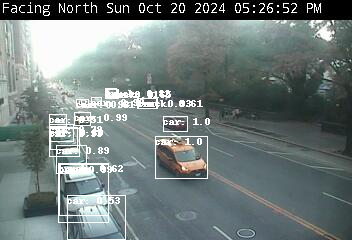

In [18]:
camera_result = process_camera({"id":"7e2400e3-cad2-407a-927b-d575a35048e3","name":"Central Park West @ 66 St","latitude":40.772441,"longitude":-73.978751,"area":"Manhattan","isOnline":"true","imageUrl":"https://webcams.nyctmc.org/api/cameras/7e2400e3-cad2-407a-927b-d575a35048e3/image"})
print("Object counts: "+str(camera_result.get('counts')))
camera_result.get('image')

## Processing all traffic Cameras
Now that we have identified useful features we can extract from individual traffic cameras, we want to leverage these cameras to extract broader analytics. We can continuously scrape all of the NYC traffic cameras that are available to understand the density, traffic patterns and even track objects across the city. This is parallelized to be able to scrape ~1k traffic cameras in ~2min.


In [19]:
def process_cameras(all_cameras):
    results = []

    with ThreadPoolExecutor() as executor:
        # Submit tasks for cameras in Manhattan
        future_to_camera = {executor.submit(process_camera, camera): camera for camera in all_cameras}

        # Collect results as they complete
        for future in tqdm(as_completed(future_to_camera), total=len(future_to_camera), desc="Processing Cameras"):
            results.append(future.result())

    return results

In [20]:
data = process_cameras(cameras)

Processing Cameras: 100%|██████████| 921/921 [05:47<00:00,  2.65it/s]


## Traffic Analysis
We can now plot our data on a heatmap to analyze the traffic patterns across the city. This function renders the image recognition data into an interactive map with images.

In [26]:
import folium
from folium.plugins import HeatMap
from PIL import Image
import base64
from io import BytesIO

def image_to_base64(img, format='PNG'):
    """
    Convert a PIL image to a base64 encoded string.

    Args:
        img (PIL.Image): The image to encode.
        format (str): The format for the encoded image (default is 'PNG').

    Returns:
        str: Base64 encoded string of the image.
    """
    buffered = BytesIO()
    img.save(buffered, format=format)
    return base64.b64encode(buffered.getvalue()).decode()

def render_map(data):
    """
    Render a heatmap and markers on a folium map based on input data.

    Args:
        data (list): A list of dictionaries containing 'latitude', 'longitude',
                     'counts', and optional 'image' keys.

    Returns:
        folium.Map: A folium map object with a heatmap and markers.
    """
    # Create a transparent image for the marker icon
    transparent_icon = Image.new("RGBA", (1, 1), (255, 255, 255, 0))  # 1x1 pixel transparent image
    transparent_icon_base64 = image_to_base64(transparent_icon, format='PNG')

    # Extract data for heatmap in the format: [lat, lon, weight]
    heat_data = [
        [item['latitude'], item['longitude'], sum(item['counts'].values())]
        for item in data if sum(item['counts'].values()) > 0  # Filter out locations with no objects
    ]

    # Create a base map centered around New York
    map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

    # Add heatmap to the map
    HeatMap(heat_data, radius=20).add_to(map)

    # Add invisible markers with image popups
    for item in data:
        if item.get('image') is not None:  # Check if there's an image
            encoded_image = image_to_base64(item['image'], format='JPEG')  # Encode the image in JPEG
            popup_html = f"""
            <img src="data:image/jpeg;base64,{encoded_image}" width="300" height="200">
            <p>{item['counts']}</p>
            """
            popup = folium.Popup(popup_html, max_width=300)
            
            # Add marker with transparent icon and the image popup
            folium.Marker(
                location=[item['latitude'], item['longitude']],
                icon=folium.CustomIcon(
                    icon_image=f"data:image/png;base64,{transparent_icon_base64}",
                    icon_size=(30, 30)  # Invisible marker size
                ),
                popup=popup
            ).add_to(map)

    return map


## Processing All Traffic Cameras
Once a handle on the features extracted from individual cameras is established, the analysis is scaled up. Continuous scraping of images from the entire network of NYC traffic cameras enables broader analytics on traffic density and patterns. With a parallelized scraping approach, tracking the movement of objects across the city in real time becomes possible.

This large-scale data collection helps identify traffic trends, peak congestion times, and the distribution of vehicles and pedestrians throughout the city. Ultimately, this information can inform better traffic management strategies and infrastructure planning.


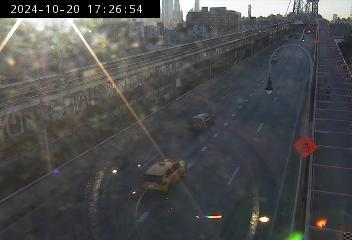
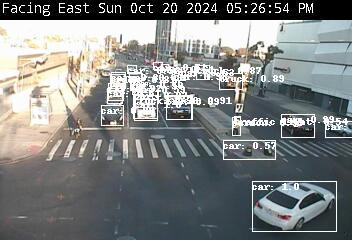
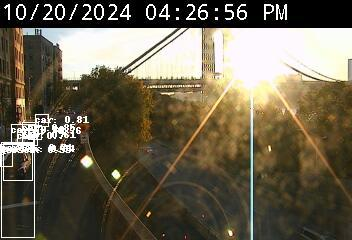
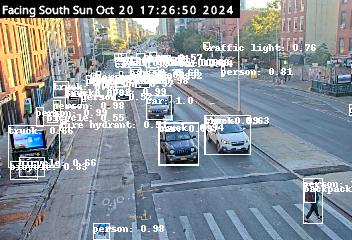
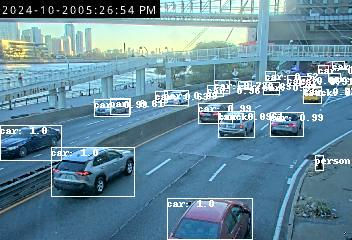
...
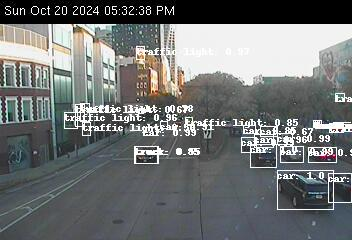
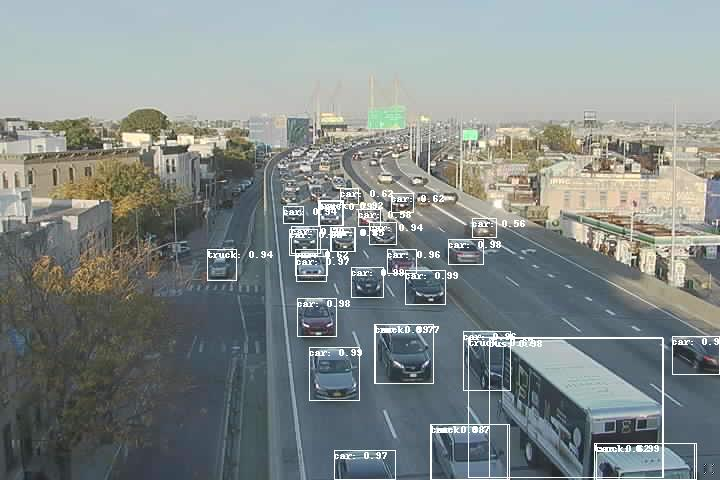
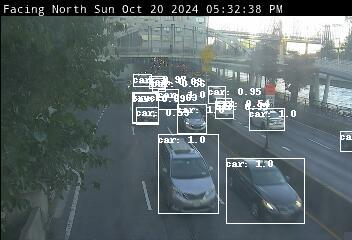
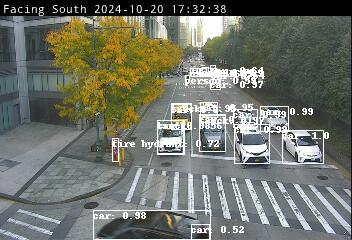
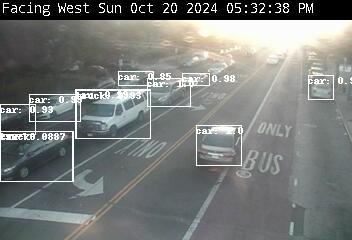

In [27]:
map = render_map(data)

map

## Results
The analysis of traffic camera data has led to the creation of detailed heatmaps that visualize traffic density across various locations in New York City. These heatmaps are generated by aggregating data from multiple traffic cameras and using AI algorithms to identify and quantify vehicle and pedestrian counts.

### Heatmap Correlation with Average Traffic
The generated heatmaps effectively align with known patterns of average traffic in NYC. By comparing the heatmap outputs with historical traffic data, it is evident that areas identified as high-density zones correlate with regions typically known for congestion, such as major intersections and commercial districts.

This alignment validates the accuracy of the analysis and highlights the model's ability to reflect real-world traffic conditions. The heatmaps serve as a visual representation of traffic flow, enabling stakeholders to quickly grasp areas of high activity and congestion.

### Determining Density and Traffic Levels
Through the use of advanced image recognition techniques and data aggregation, it is possible to accurately determine traffic density and levels across the city. The analysis reveals patterns such as peak traffic hours, frequent congestion points, and variations in pedestrian activity throughout the day.

This capability allows for a dynamic understanding of traffic patterns, making it easier to assess the impact of events or changes in urban infrastructure. Moreover, the insights gained can assist city planners and traffic managers in developing strategies to alleviate congestion and enhance urban mobility.

By integrating these findings into a real-time monitoring system, NYC can leverage AI-driven analytics to make data-informed decisions that improve traffic management and contribute to the overall efficiency of the transportation network.

## Conclusions
Analyzing NYC traffic cameras with the COCO Image Recognition model allows for the extraction of valuable insights that enhance the understanding of urban traffic dynamics. The ability to process around 1,000 cameras in about 2 minutes provides a significant edge in accessing real-time analytics.

These findings not only contribute to city planning and traffic management but also open the door to developing interactive real-time dashboards. Such dashboards could visualize traffic patterns, highlight congestion hotspots, and provide predictive insights for better decision-making. Furthermore, the object tracking capabilities developed through this analysis could be extended to monitor the movement of vehicles and pedestrians across the city. This level of granularity could enhance safety measures and inform urban planning efforts, ultimately leading to safer and more efficient navigation throughout NYC.